# <center>Лабораторна робота №2 з дисципліни "Вступ до машинного навчання".

# <center>Виконав: Терещенко Олексій, ДА-21.


Імпортуємо бібліотеки для аналізу даних


In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Зчитаємо дані з csv файлів. Використовуємо тренувальний та тестовий набори даних:


In [56]:
pd.options.display.max_rows = None
train_data = pd.read_csv("application_train.csv")


test_data = pd.read_csv("application_test.csv")

Подивимось перші кілька рядків та колонок нашого набору даних:


In [57]:
train_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [58]:
test_data.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


Перевіримо кількість рядків і колонок (shape) наших даних.


In [59]:
train_data.shape

(307511, 122)

In [60]:
test_data.shape

(48744, 121)

Визначимо типи даних та їх частоти.


In [61]:
train_data.dtypes.value_counts()

float64    65
int64      41
object     16
Name: count, dtype: int64

In [62]:
test_data.dtypes.value_counts()

float64    65
int64      40
object     16
Name: count, dtype: int64

Знайдемо кількість пропущених значень та унікальних значень у кожній колонці:


In [63]:
train_data.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [64]:
test_data.isnull().sum()

SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                        24
AMT_GOODS_PRICE                     0
NAME_TYPE_SUITE                   911
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                     32312
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

In [65]:
train_data.nunique()

SK_ID_CURR                      307511
TARGET                               2
NAME_CONTRACT_TYPE                   2
CODE_GENDER                          3
FLAG_OWN_CAR                         2
FLAG_OWN_REALTY                      2
CNT_CHILDREN                        15
AMT_INCOME_TOTAL                  2548
AMT_CREDIT                        5603
AMT_ANNUITY                      13672
AMT_GOODS_PRICE                   1002
NAME_TYPE_SUITE                      7
NAME_INCOME_TYPE                     8
NAME_EDUCATION_TYPE                  5
NAME_FAMILY_STATUS                   6
NAME_HOUSING_TYPE                    6
REGION_POPULATION_RELATIVE          81
DAYS_BIRTH                       17460
DAYS_EMPLOYED                    12574
DAYS_REGISTRATION                15688
DAYS_ID_PUBLISH                   6168
OWN_CAR_AGE                         62
FLAG_MOBIL                           2
FLAG_EMP_PHONE                       2
FLAG_WORK_PHONE                      2
FLAG_CONT_MOBILE         

In [66]:
test_data.nunique()

SK_ID_CURR                      48744
NAME_CONTRACT_TYPE                  2
CODE_GENDER                         2
FLAG_OWN_CAR                        2
FLAG_OWN_REALTY                     2
CNT_CHILDREN                       11
AMT_INCOME_TOTAL                  606
AMT_CREDIT                       2937
AMT_ANNUITY                      7491
AMT_GOODS_PRICE                   677
NAME_TYPE_SUITE                     7
NAME_INCOME_TYPE                    7
NAME_EDUCATION_TYPE                 5
NAME_FAMILY_STATUS                  5
NAME_HOUSING_TYPE                   6
REGION_POPULATION_RELATIVE         81
DAYS_BIRTH                      15477
DAYS_EMPLOYED                    7863
DAYS_REGISTRATION               12618
DAYS_ID_PUBLISH                  5880
OWN_CAR_AGE                        52
FLAG_MOBIL                          2
FLAG_EMP_PHONE                      2
FLAG_WORK_PHONE                     2
FLAG_CONT_MOBILE                    2
FLAG_PHONE                          2
FLAG_EMAIL  

Видалимо колонки, які мають занадто велике число пропусків, у даному випадку взяли більше 90 000 (більше 30% пропущених значень).


In [67]:
train_data = train_data.drop(
    train_data.columns[train_data.isnull().sum() > 90000], axis=1
)

In [68]:
test_data = test_data.drop(
    train_data.columns[train_data.isnull().sum() > 90000], axis=1
)

Порахуємо кількість дублікатів:


In [69]:
train_data.drop(columns=["SK_ID_CURR"], axis=1).duplicated().sum()

np.int64(0)

In [70]:
test_data.drop(columns=["SK_ID_CURR"], axis=1).duplicated().sum()

np.int64(0)

Опишемо статистичні характеристики даних за допомогою describe:


In [71]:
train_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [72]:
test_data.describe()

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,48744.000000,48744.000000,...,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,67485.366322,-4967.652716,...,0.001559,0.0,0.0,0.0,0.002108,0.001803,0.002787,0.009299,0.546902,1.983769
std,103169.547296,0.709047,1.015226e+05,3.653970e+05,16016.368315,3.367102e+05,0.014428,4325.900393,144348.507136,3552.612035,...,0.039456,0.0,0.0,0.0,0.046373,0.046132,0.054037,0.110924,0.693305,1.838873
min,100001.000000,0.000000,2.694150e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,-25195.000000,-17463.000000,-23722.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,188557.750000,0.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,-19637.000000,-2910.000000,-7459.250000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,277549.000000,0.000000,1.575000e+05,4.500000e+05,26199.000000,3.960000e+05,0.018850,-15785.000000,-1293.000000,-4490.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,367555.500000,1.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,-12496.000000,-296.000000,-1901.000000,...,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000
max,456250.000000,20.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,-7338.000000,365243.000000,0.000000,...,1.000000,0.0,0.0,0.0,2.000000,2.000000,2.000000,6.000000,7.000000,17.000000


Збудуємо кореляційну матрицю:


In [73]:
numerical_columns = train_data.select_dtypes(include=["number"])

correlation_matrix = numerical_columns.corr()

correlation_matrix

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
SK_ID_CURR,1.000000,-0.002108,-0.001129,-0.001820,-0.000343,-0.000433,-0.000232,0.000849,-0.001500,0.001366,...,0.000509,0.000167,0.001073,0.000282,-0.002672,-0.002193,0.002099,0.000485,0.001025,0.004659
TARGET,-0.002108,1.000000,0.019187,-0.003982,-0.030369,-0.012817,-0.039645,-0.037227,0.078239,-0.044932,...,-0.007952,-0.001358,0.000215,0.003709,0.000930,0.002704,0.000788,-0.012462,-0.002022,0.019930
CNT_CHILDREN,-0.001129,0.019187,1.000000,0.012882,0.002145,0.021374,-0.001827,-0.025573,0.330938,-0.239818,...,0.004031,0.000864,0.000988,-0.002450,-0.000410,-0.000366,-0.002436,-0.010808,-0.007836,-0.041550
AMT_INCOME_TOTAL,-0.001820,-0.003982,0.012882,1.000000,0.156870,0.191657,0.159610,0.074796,0.027261,-0.064223,...,0.003130,0.002408,0.000242,-0.000589,0.000709,0.002944,0.002387,0.024700,0.004859,0.011690
AMT_CREDIT,-0.000343,-0.030369,0.002145,0.156870,1.000000,0.770138,0.986968,0.099738,-0.055436,-0.066838,...,0.034329,0.021082,0.031023,-0.016148,-0.003906,0.004238,-0.001275,0.054451,0.015925,-0.048448
AMT_ANNUITY,-0.000433,-0.012817,0.021374,0.191657,0.770138,1.000000,0.775109,0.118429,0.009445,-0.104332,...,-0.009745,0.004573,0.011718,-0.017598,0.003861,0.002185,0.013881,0.039148,0.010124,-0.011320
AMT_GOODS_PRICE,-0.000232,-0.039645,-0.001827,0.159610,0.986968,0.775109,1.000000,0.103520,-0.053442,-0.064842,...,0.032748,0.020279,0.031640,-0.014486,-0.003237,0.004677,-0.001007,0.056422,0.016432,-0.050998
REGION_POPULATION_RELATIVE,0.000849,-0.037227,-0.025573,0.074796,0.099738,0.118429,0.103520,1.000000,-0.029582,-0.003980,...,0.013367,0.002364,-0.000045,0.003437,-0.002225,0.001399,-0.002149,0.078607,-0.001279,0.001003
DAYS_BIRTH,-0.001500,0.078239,0.330938,0.027261,-0.055436,0.009445,-0.053442,-0.029582,1.000000,-0.615864,...,0.044498,0.003614,0.009015,0.027282,0.005285,0.002255,-0.001336,0.001372,-0.011799,-0.071983
DAYS_EMPLOYED,0.001366,-0.044932,-0.239818,-0.064223,-0.066838,-0.104332,-0.064842,-0.003980,-0.615864,1.000000,...,-0.040396,-0.010040,-0.010135,-0.008396,-0.004735,0.000472,0.003072,-0.034457,0.015345,0.049988


Візьмемо тільки кореляцію з нашою колонкою TARGET, та визначимо ті, у яких кореляція висока (більша за 0.5)


In [74]:
correlation_with_target = correlation_matrix["TARGET"].abs()

highly_correlated_features = correlation_with_target[
    correlation_with_target > 0.5
].index.tolist()

print(highly_correlated_features)

['TARGET']


Як можна побачити, високу кореляцію з TARGET має тільки сам TARGET


Подивимося на всі нечислові стовпці:


In [75]:
# Кількість унікальних значень для кожної колонки
unique_counts = train_data.nunique()

# Вибираємо числові колонки, які мають мало унікальних значень
low_unique_numeric = unique_counts[
    (unique_counts <= 10)
    & (train_data.dtypes.isin(["int64", "float64"]))
    & (unique_counts.index != "TARGET")
].index

train_data[low_unique_numeric] = train_data[low_unique_numeric].astype("category")

In [76]:
categorical_columns = train_data.select_dtypes(exclude=["float64", "int64"]).columns
numerical_columns = (
    train_data.drop(columns=["TARGET"], axis=1)
    .select_dtypes(include=["float64", "int64"])
    .columns
)

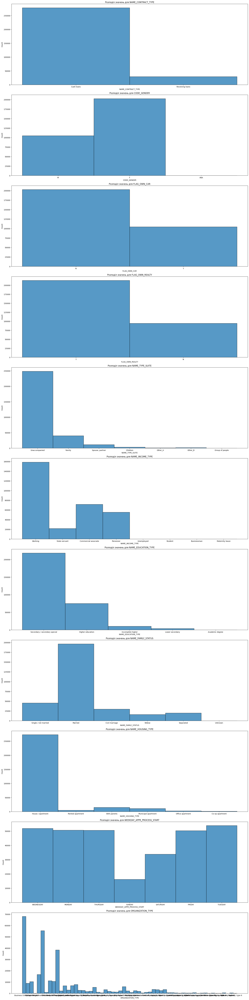

In [77]:
fig, axes = plt.subplots(nrows=len(categorical_columns), ncols=1, figsize=(20, 80))

for i, col in enumerate(categorical_columns):
    sns.histplot(data=train_data, x=col, kde=False, ax=axes[i])
    axes[i].set_title(f"Розподіл значень для {col}")

plt.tight_layout()
plt.show()

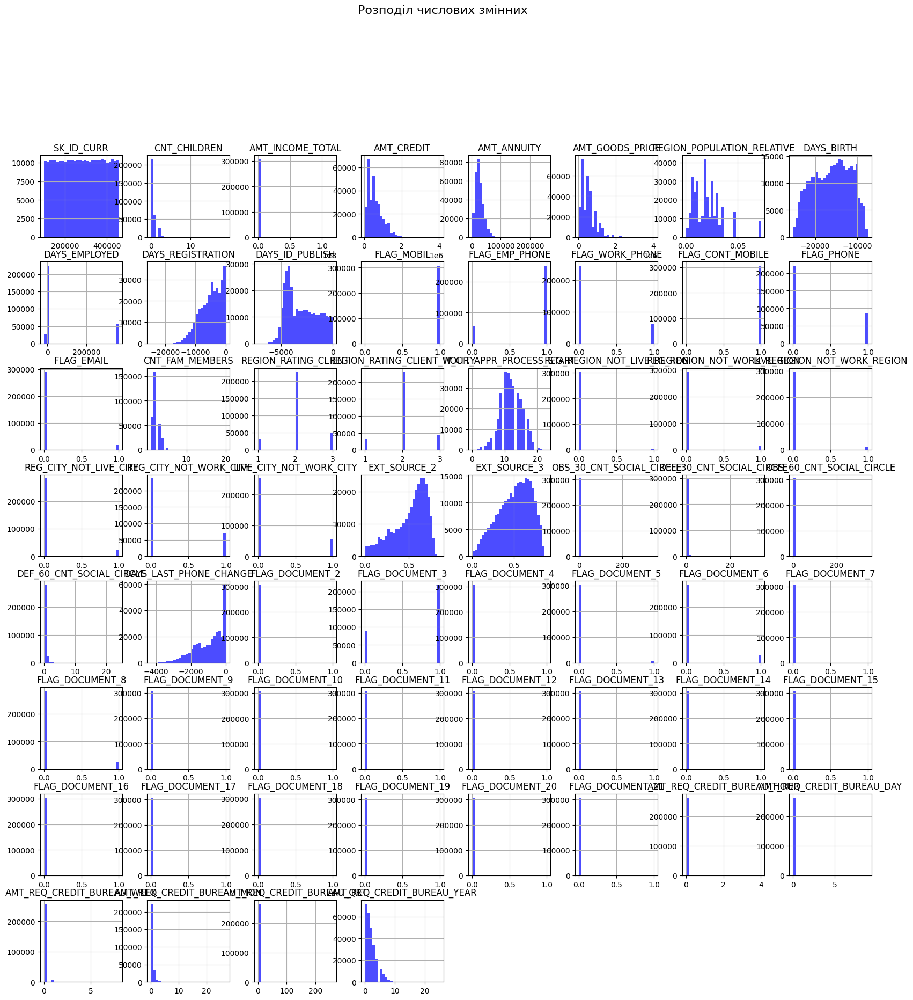

In [78]:
train_data[numerical_columns].hist(figsize=(20, 20), bins=30, color="blue", alpha=0.7)

plt.suptitle("Розподіл числових змінних", y=1.02, fontsize=16)
plt.show()

In [79]:
train_data.isnull().sum()

SK_ID_CURR                         0
TARGET                             0
NAME_CONTRACT_TYPE                 0
CODE_GENDER                        0
FLAG_OWN_CAR                       0
FLAG_OWN_REALTY                    0
CNT_CHILDREN                       0
AMT_INCOME_TOTAL                   0
AMT_CREDIT                         0
AMT_ANNUITY                       12
AMT_GOODS_PRICE                  278
NAME_TYPE_SUITE                 1292
NAME_INCOME_TYPE                   0
NAME_EDUCATION_TYPE                0
NAME_FAMILY_STATUS                 0
NAME_HOUSING_TYPE                  0
REGION_POPULATION_RELATIVE         0
DAYS_BIRTH                         0
DAYS_EMPLOYED                      0
DAYS_REGISTRATION                  0
DAYS_ID_PUBLISH                    0
FLAG_MOBIL                         0
FLAG_EMP_PHONE                     0
FLAG_WORK_PHONE                    0
FLAG_CONT_MOBILE                   0
FLAG_PHONE                         0
FLAG_EMAIL                         0
C

In [80]:
test_data.isnull().sum()

SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                        24
AMT_GOODS_PRICE                     0
NAME_TYPE_SUITE                   911
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                     32312
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

Заповнимо колонки які мають пропуски. <br>
Використаємо моду для категоріальних або числових даних з малою кількістю унікальних значень.<br>
Використаємо середнє значення для числових даних з великою кількістю унікальних значень.<br>
Використаємо медіану для AMT_ANNUITY, через її зменшений вплив викидів.


In [81]:
train_data["OBS_30_CNT_SOCIAL_CIRCLE"] = train_data["OBS_30_CNT_SOCIAL_CIRCLE"].fillna(
    train_data["OBS_30_CNT_SOCIAL_CIRCLE"].median()
)

train_data["DEF_30_CNT_SOCIAL_CIRCLE"] = train_data["DEF_30_CNT_SOCIAL_CIRCLE"].fillna(
    train_data["DEF_30_CNT_SOCIAL_CIRCLE"].median()
)

train_data["OBS_60_CNT_SOCIAL_CIRCLE"] = train_data["OBS_60_CNT_SOCIAL_CIRCLE"].fillna(
    train_data["OBS_60_CNT_SOCIAL_CIRCLE"].median()
)

train_data["DEF_60_CNT_SOCIAL_CIRCLE"] = train_data["DEF_60_CNT_SOCIAL_CIRCLE"].fillna(
    train_data["DEF_60_CNT_SOCIAL_CIRCLE"].median()
)

train_data["NAME_TYPE_SUITE"] = train_data["NAME_TYPE_SUITE"].fillna(
    train_data["NAME_TYPE_SUITE"].mode()[0]
)

train_data["AMT_GOODS_PRICE"] = train_data["AMT_GOODS_PRICE"].fillna(
    train_data["AMT_GOODS_PRICE"].median()
)

train_data["AMT_ANNUITY"] = train_data["AMT_ANNUITY"].fillna(
    train_data["AMT_ANNUITY"].median()
)

train_data["DAYS_LAST_PHONE_CHANGE"] = train_data["DAYS_LAST_PHONE_CHANGE"].fillna(
    train_data["DAYS_LAST_PHONE_CHANGE"].median()
)

train_data["CNT_FAM_MEMBERS"] = train_data["CNT_FAM_MEMBERS"].fillna(
    train_data["CNT_FAM_MEMBERS"].median()
)

train_data["EXT_SOURCE_2"] = train_data["EXT_SOURCE_2"].fillna(
    train_data["EXT_SOURCE_2"].median()
)

train_data["EXT_SOURCE_3"] = train_data["EXT_SOURCE_3"].fillna(
    train_data["EXT_SOURCE_3"].mean()
)

train_data["AMT_REQ_CREDIT_BUREAU_HOUR"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_HOUR"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_HOUR"].median())

train_data["AMT_REQ_CREDIT_BUREAU_DAY"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_DAY"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_DAY"].median())

train_data["AMT_REQ_CREDIT_BUREAU_WEEK"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_WEEK"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_WEEK"].median())

train_data["AMT_REQ_CREDIT_BUREAU_MON"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_MON"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_MON"].median())

train_data["AMT_REQ_CREDIT_BUREAU_QRT"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_QRT"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_QRT"].median())

train_data["AMT_REQ_CREDIT_BUREAU_YEAR"] = train_data[
    "AMT_REQ_CREDIT_BUREAU_YEAR"
].fillna(train_data["AMT_REQ_CREDIT_BUREAU_YEAR"].median())

In [82]:
test_data["OBS_30_CNT_SOCIAL_CIRCLE"] = test_data["OBS_30_CNT_SOCIAL_CIRCLE"].fillna(
    test_data["OBS_30_CNT_SOCIAL_CIRCLE"].median()
)

test_data["DEF_30_CNT_SOCIAL_CIRCLE"] = test_data["DEF_30_CNT_SOCIAL_CIRCLE"].fillna(
    test_data["DEF_30_CNT_SOCIAL_CIRCLE"].median()
)

test_data["OBS_60_CNT_SOCIAL_CIRCLE"] = test_data["OBS_60_CNT_SOCIAL_CIRCLE"].fillna(
    test_data["OBS_60_CNT_SOCIAL_CIRCLE"].median()
)

test_data["DEF_60_CNT_SOCIAL_CIRCLE"] = test_data["DEF_60_CNT_SOCIAL_CIRCLE"].fillna(
    test_data["DEF_60_CNT_SOCIAL_CIRCLE"].median()
)

test_data["NAME_TYPE_SUITE"] = test_data["NAME_TYPE_SUITE"].fillna(
    test_data["NAME_TYPE_SUITE"].mode()[0]
)

test_data["AMT_GOODS_PRICE"] = test_data["AMT_GOODS_PRICE"].fillna(
    test_data["AMT_GOODS_PRICE"].median()
)

test_data["AMT_ANNUITY"] = test_data["AMT_ANNUITY"].fillna(
    test_data["AMT_ANNUITY"].median()
)

test_data["DAYS_LAST_PHONE_CHANGE"] = test_data["DAYS_LAST_PHONE_CHANGE"].fillna(
    test_data["DAYS_LAST_PHONE_CHANGE"].median()
)

test_data["CNT_FAM_MEMBERS"] = test_data["CNT_FAM_MEMBERS"].fillna(
    test_data["CNT_FAM_MEMBERS"].median()
)

test_data["EXT_SOURCE_2"] = test_data["EXT_SOURCE_2"].fillna(
    test_data["EXT_SOURCE_2"].median()
)


test_data["EXT_SOURCE_3"] = test_data["EXT_SOURCE_3"].fillna(
    test_data["EXT_SOURCE_3"].mean()
)

test_data["AMT_REQ_CREDIT_BUREAU_HOUR"] = test_data[
    "AMT_REQ_CREDIT_BUREAU_HOUR"
].fillna(test_data["AMT_REQ_CREDIT_BUREAU_HOUR"].median())

test_data["AMT_REQ_CREDIT_BUREAU_DAY"] = test_data["AMT_REQ_CREDIT_BUREAU_DAY"].fillna(
    test_data["AMT_REQ_CREDIT_BUREAU_DAY"].median()
)

test_data["AMT_REQ_CREDIT_BUREAU_WEEK"] = test_data[
    "AMT_REQ_CREDIT_BUREAU_WEEK"
].fillna(test_data["AMT_REQ_CREDIT_BUREAU_WEEK"].median())

test_data["AMT_REQ_CREDIT_BUREAU_MON"] = test_data["AMT_REQ_CREDIT_BUREAU_MON"].fillna(
    test_data["AMT_REQ_CREDIT_BUREAU_MON"].median()
)

test_data["AMT_REQ_CREDIT_BUREAU_QRT"] = test_data["AMT_REQ_CREDIT_BUREAU_QRT"].fillna(
    test_data["AMT_REQ_CREDIT_BUREAU_QRT"].median()
)

test_data["AMT_REQ_CREDIT_BUREAU_YEAR"] = test_data[
    "AMT_REQ_CREDIT_BUREAU_YEAR"
].fillna(test_data["AMT_REQ_CREDIT_BUREAU_YEAR"].median())

Перевіримо кількість пропусків:


In [83]:
print(train_data.isnull().sum().to_string())

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_AP

In [84]:
print(test_data.isnull().sum().to_string())

SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                         0
AMT_GOODS_PRICE                     0
NAME_TYPE_SUITE                     0
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                     32312
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

Давайте зробимо візуалізацію даних.<br> Спочатку, визначимо баланс тренувального набору даних:


In [85]:
train_data["TARGET"].value_counts(normalize=True)

TARGET
0    0.919271
1    0.080729
Name: proportion, dtype: float64

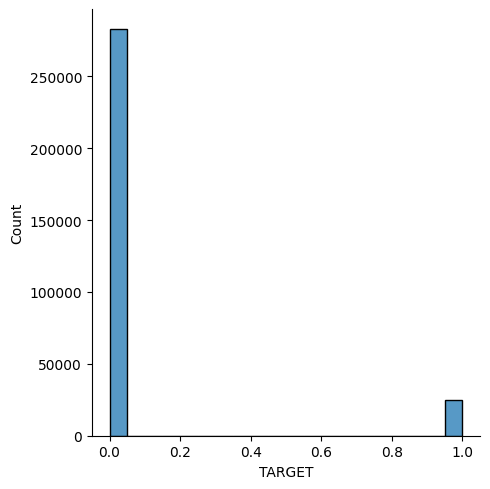

In [86]:
sns.displot(train_data["TARGET"])

Як бачимо - набір даних незбалансовано.<br> Подивимося на розподіл характеристик:


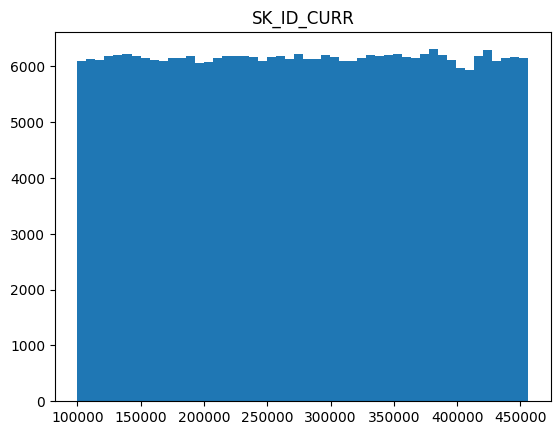

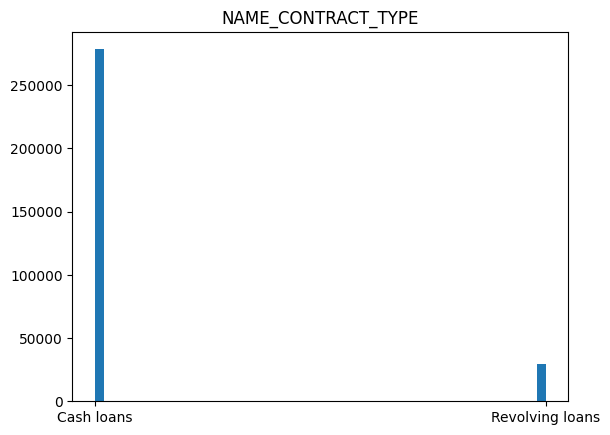

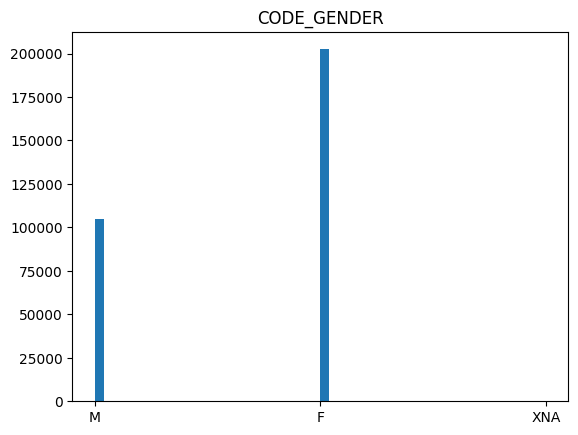

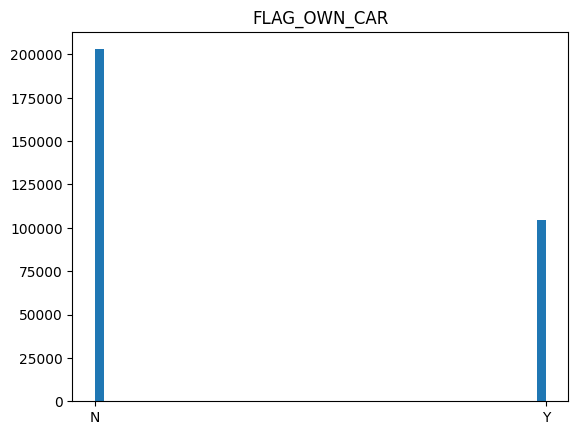

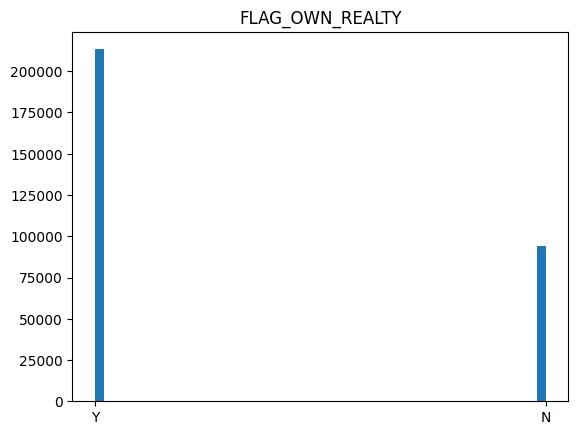

...

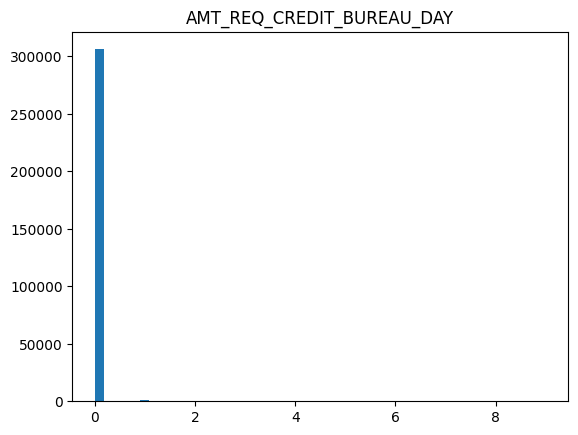

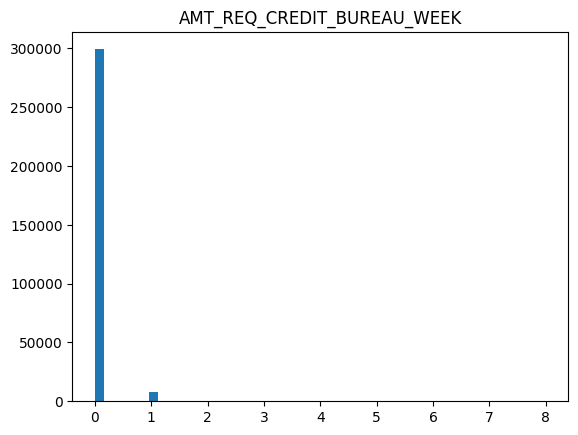

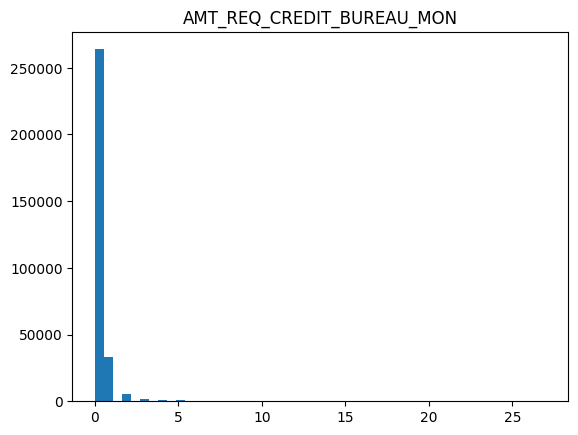

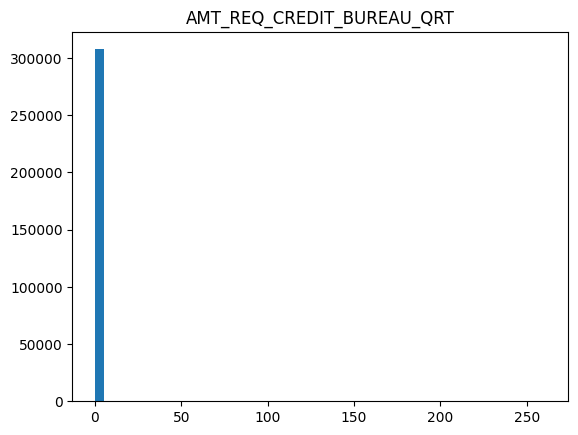

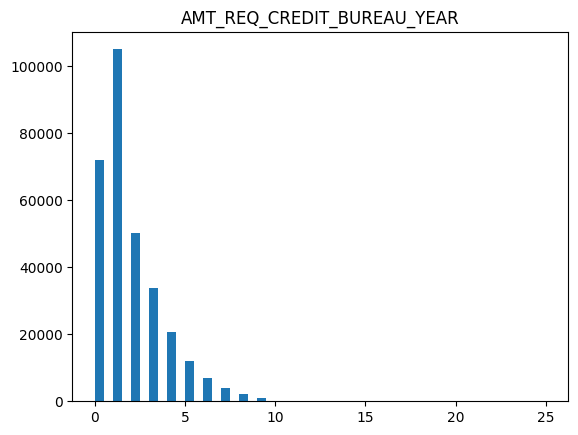

In [87]:
for column in train_data.columns:
    if column != "TARGET":
        plt.hist(train_data[column], bins=50)
        plt.title(column)
        plt.show()

Подимось на розподіл категоріальних даних:


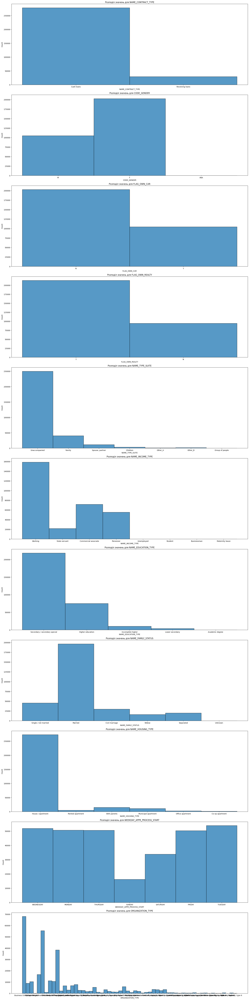

In [ ]:
categorical_columns = train_data.select_dtypes(exclude=["float64", "int64"]).columns



fig, axes = plt.subplots(nrows=len(categorical_columns), ncols=1, figsize=(20, 80))



for i, col in enumerate(categorical_columns):

    sns.histplot(data=train_data, x=col, kde=False, ax=axes[i])

    axes[i].set_title(f"Розподіл значень для {col}")



plt.tight_layout()


plt.show()

Подивимось на розподіл числових даних:


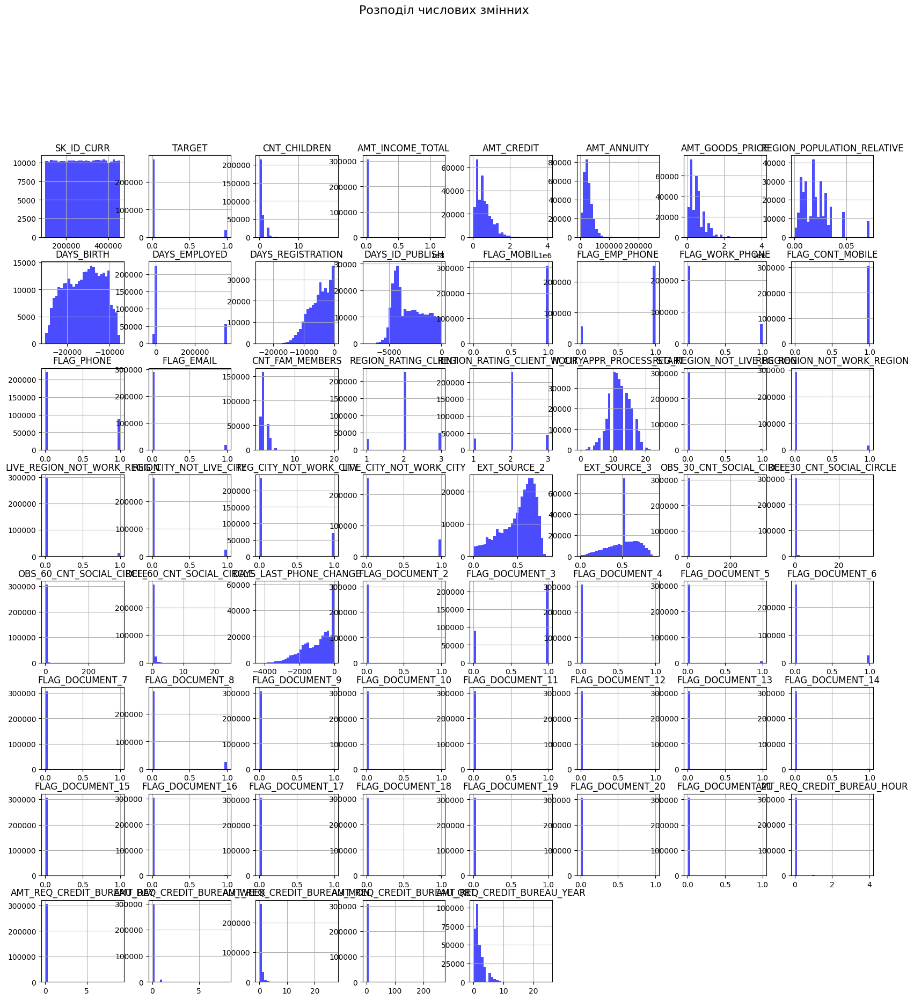

In [89]:
numerical_columns = train_data.select_dtypes(include=["float64", "int64"]).columns

train_data[numerical_columns].hist(figsize=(20, 20), bins=30, color="blue", alpha=0.7)

plt.suptitle("Розподіл числових змінних", y=1.02, fontsize=16)
plt.show()

Перевіримо різницю між тренувальним і тестовим наборами даних:


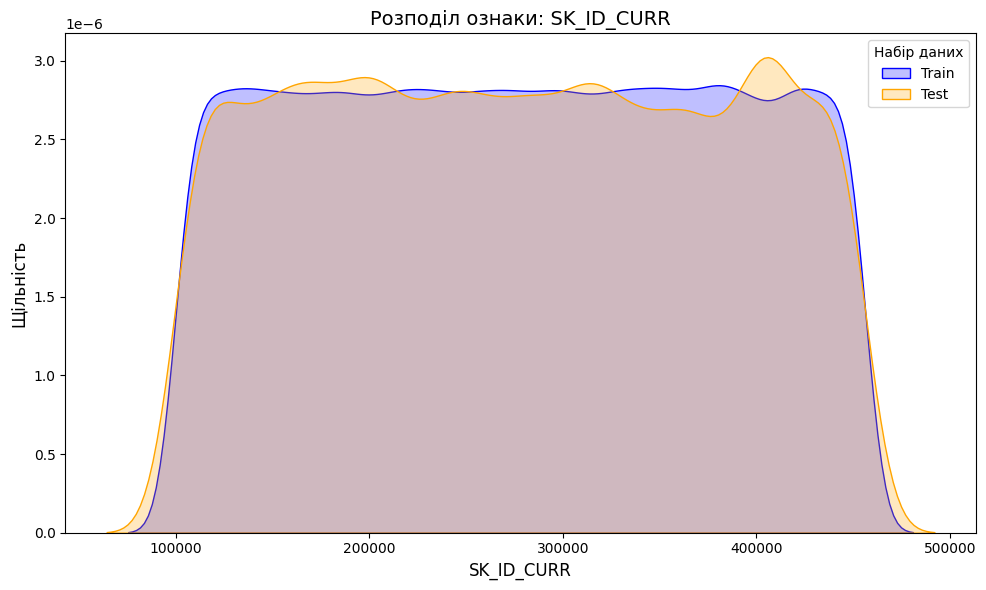

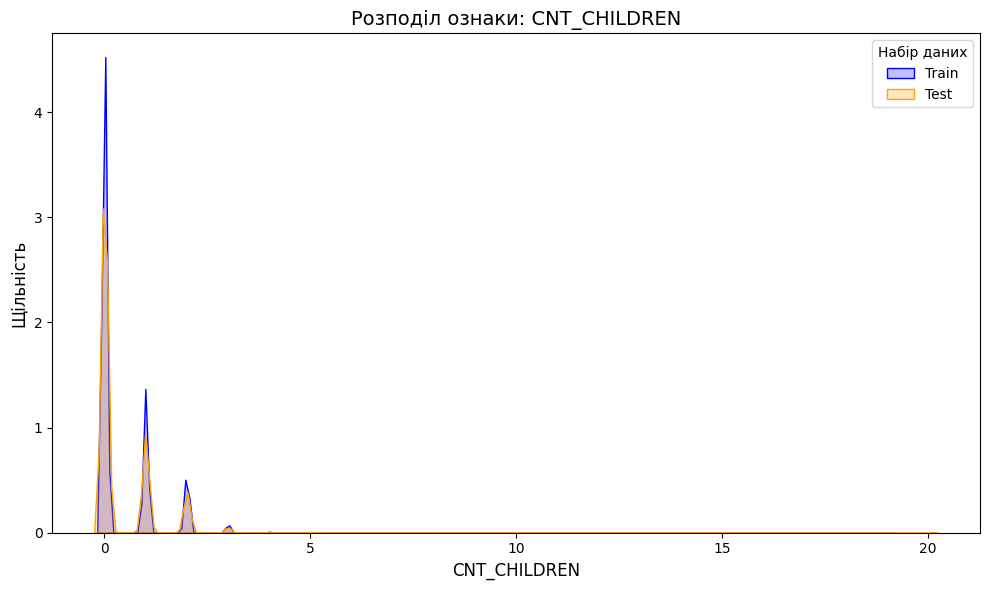

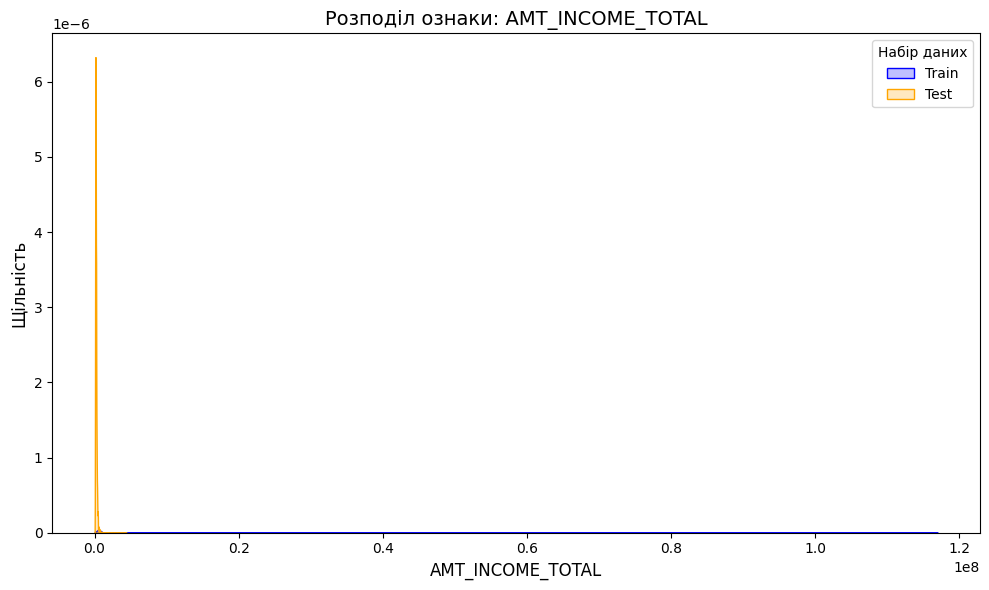

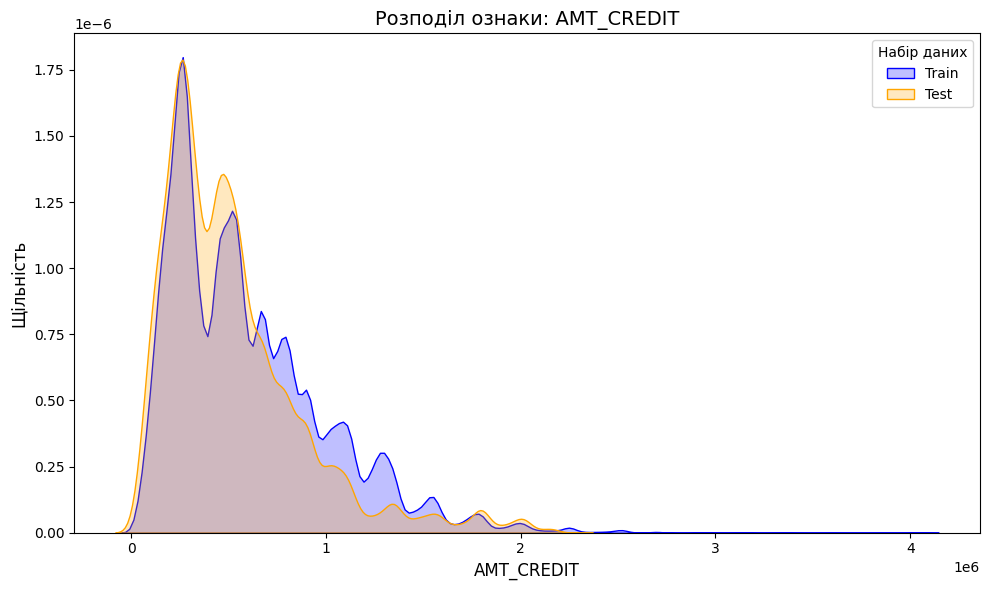

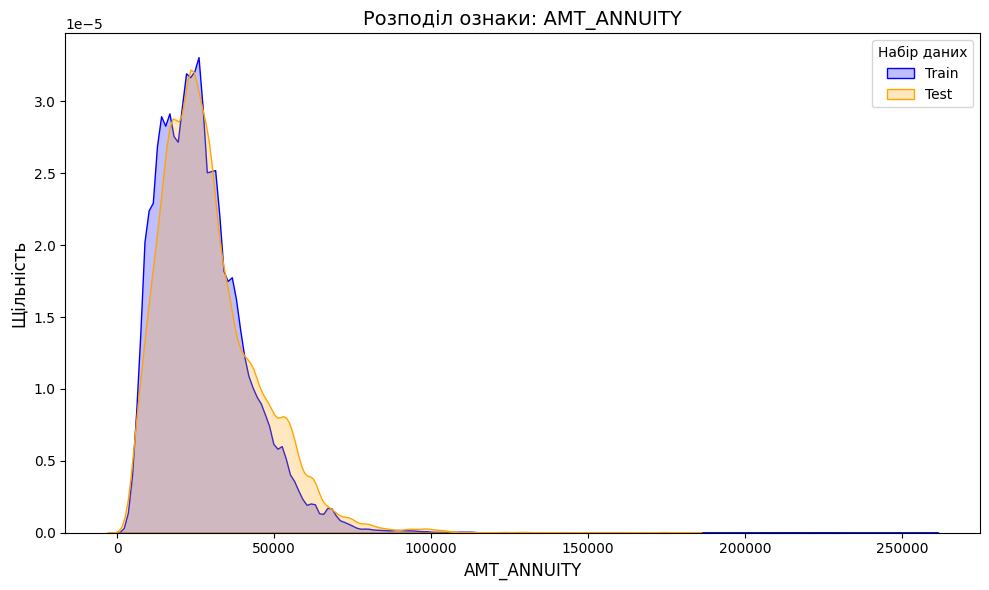

...

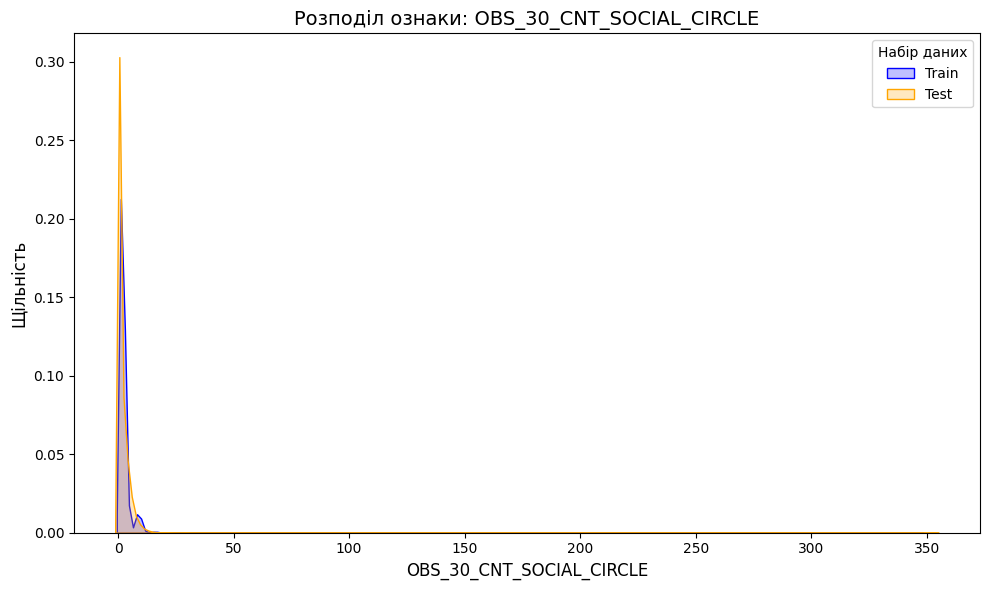

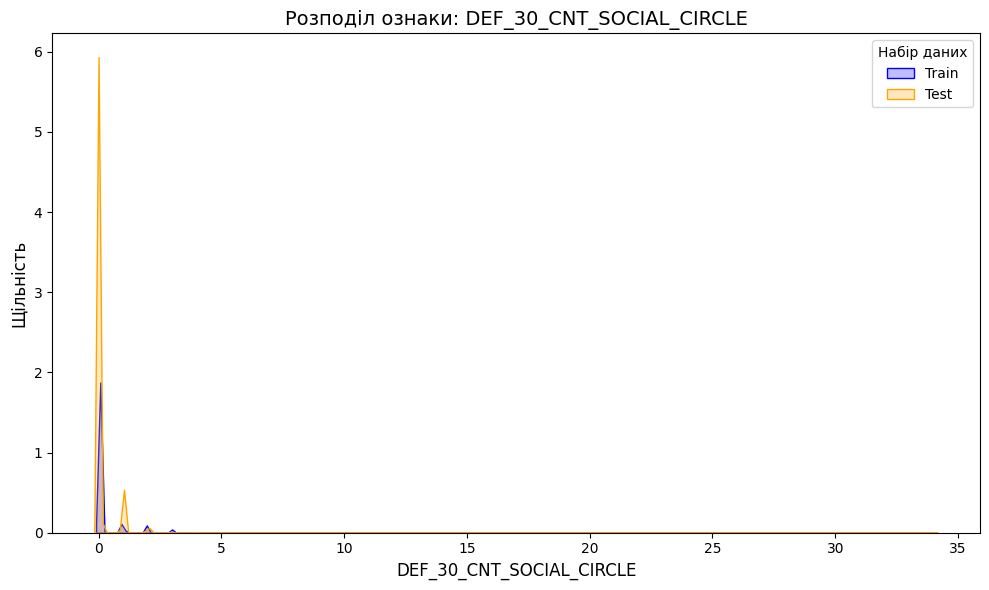

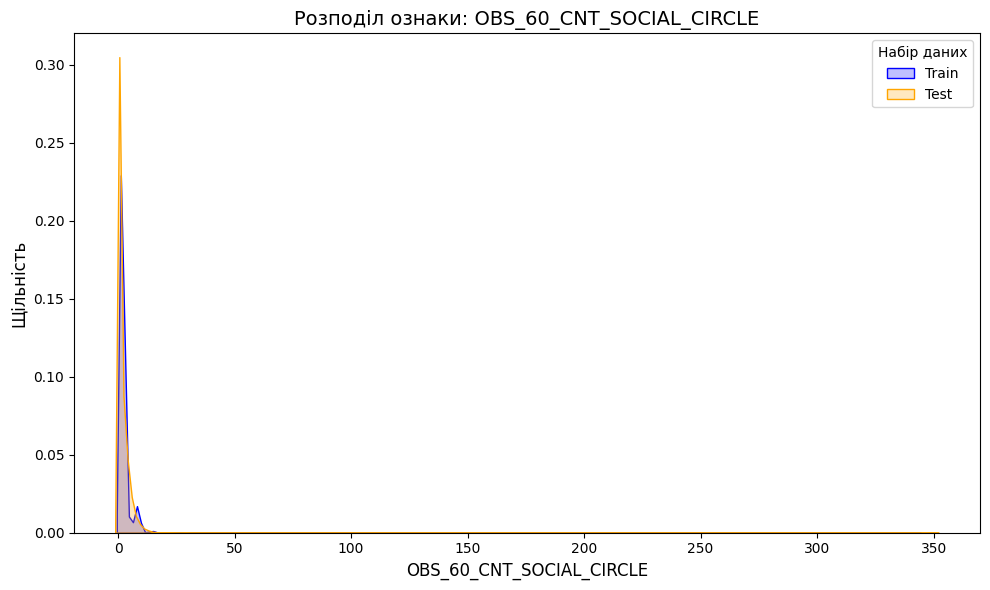

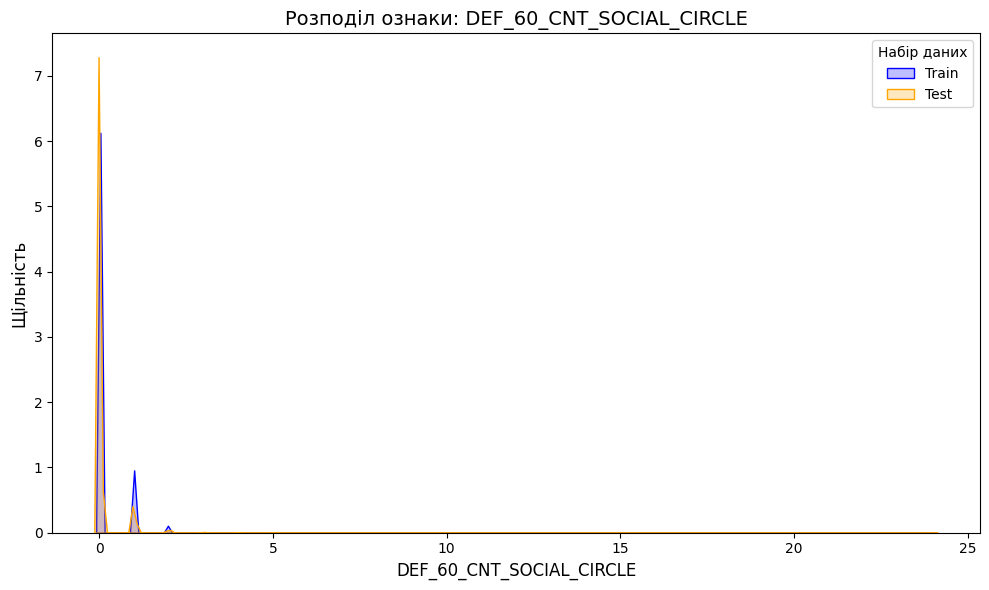

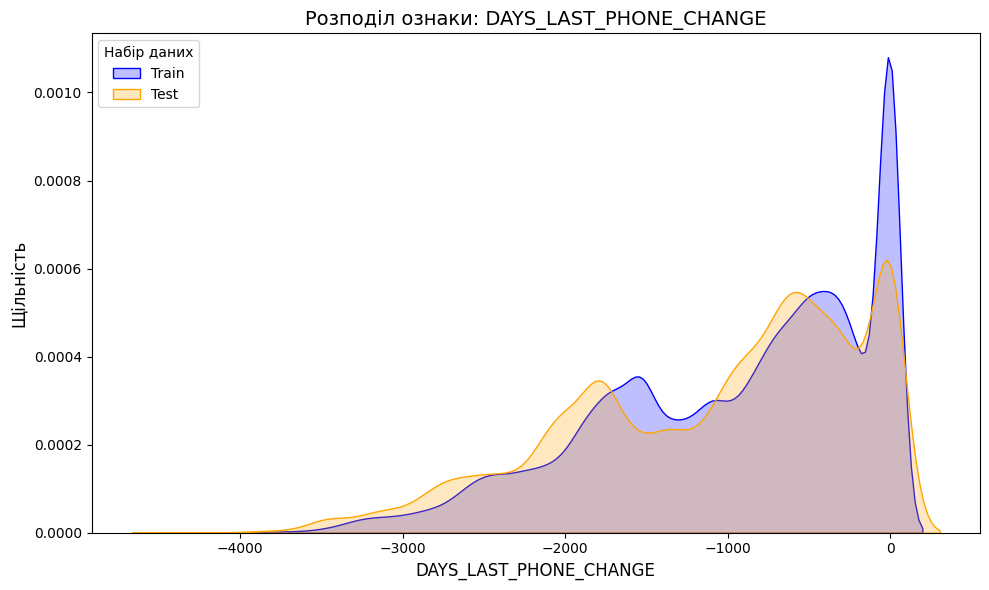

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


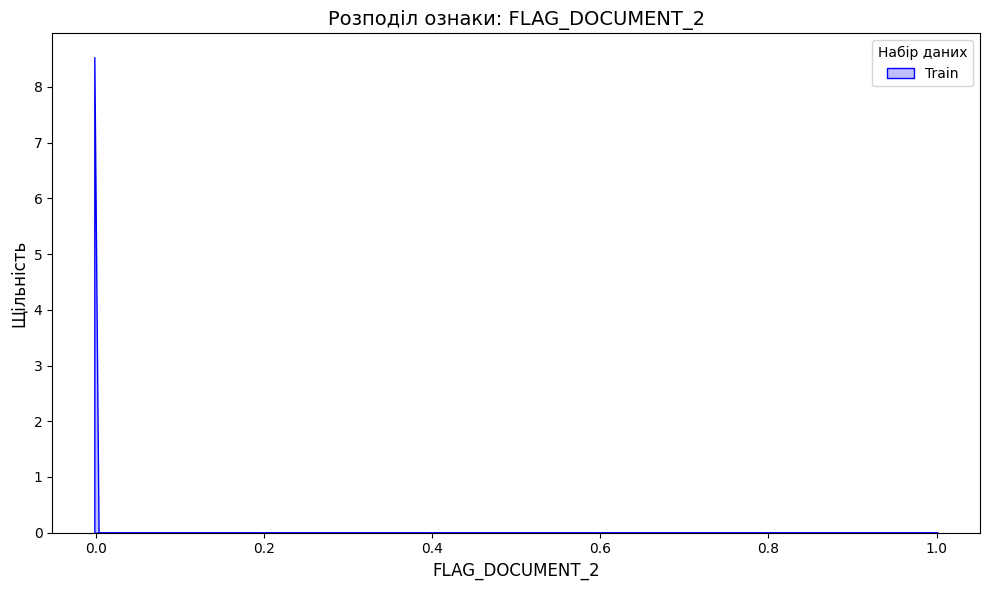

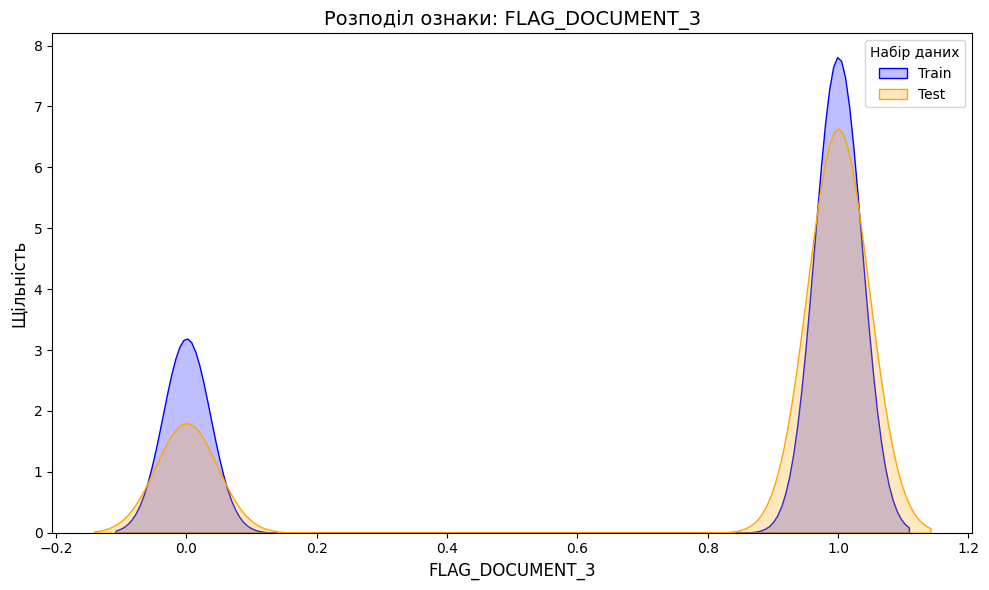

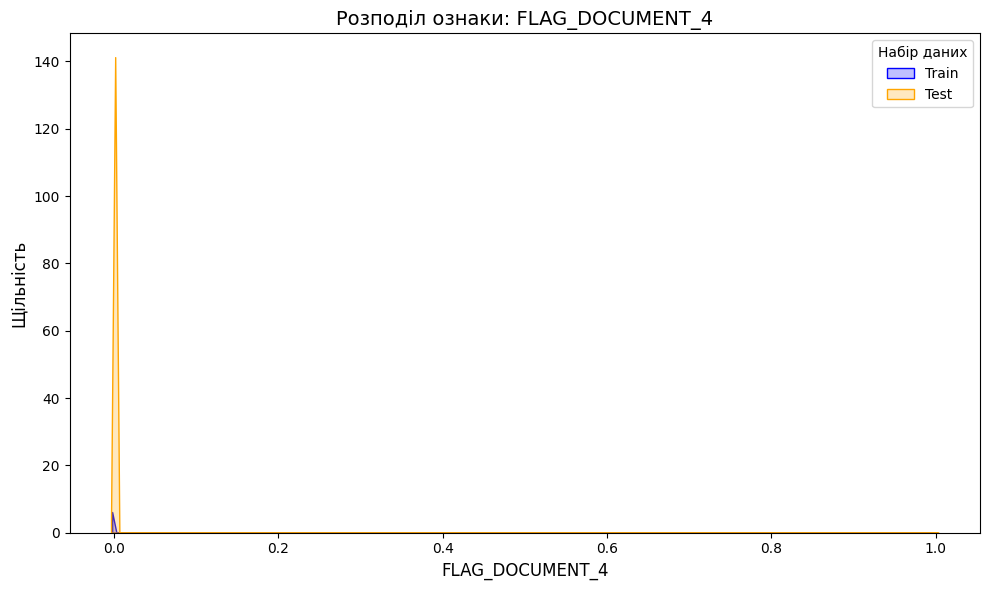

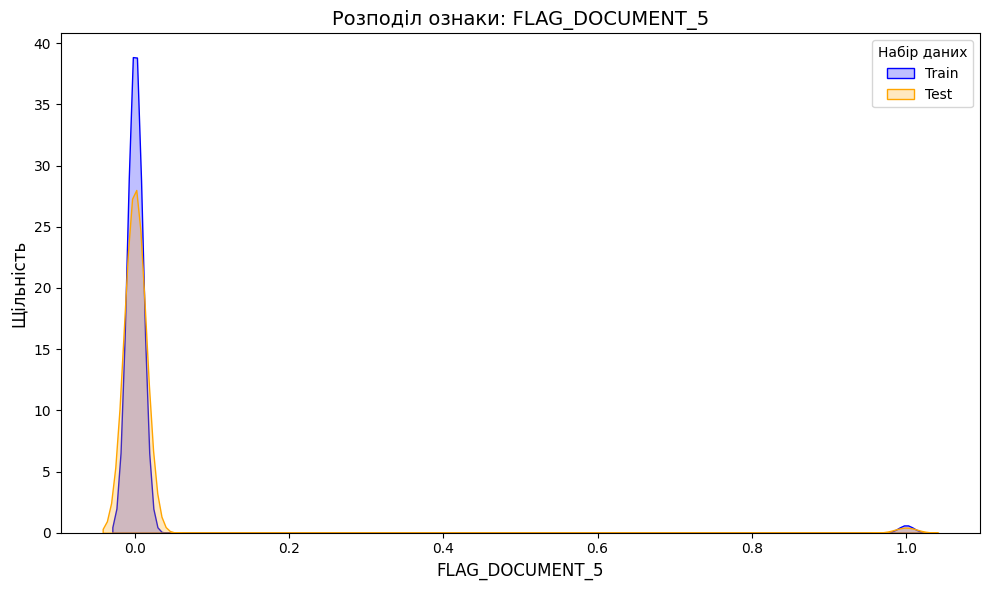

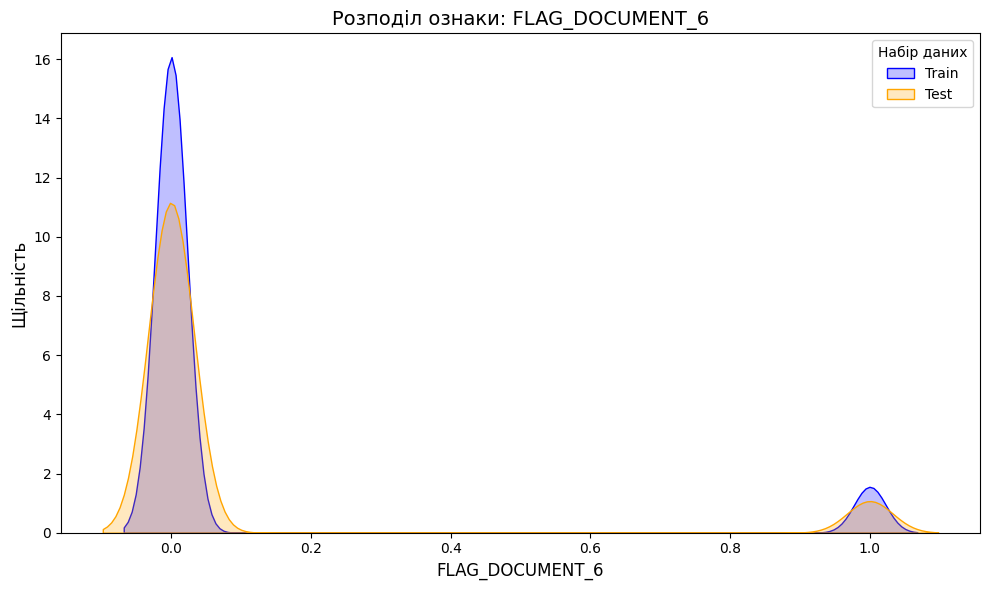

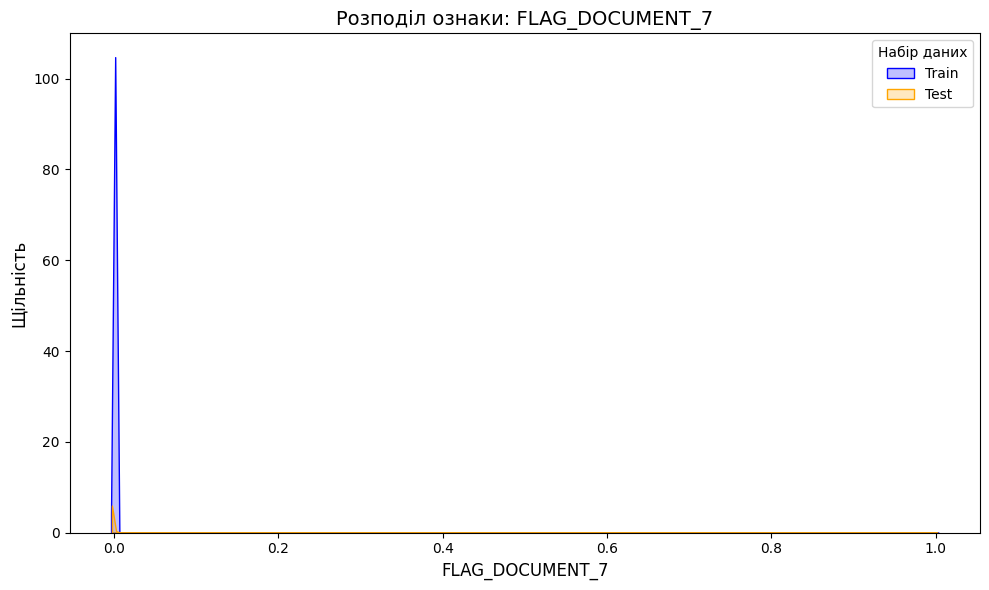

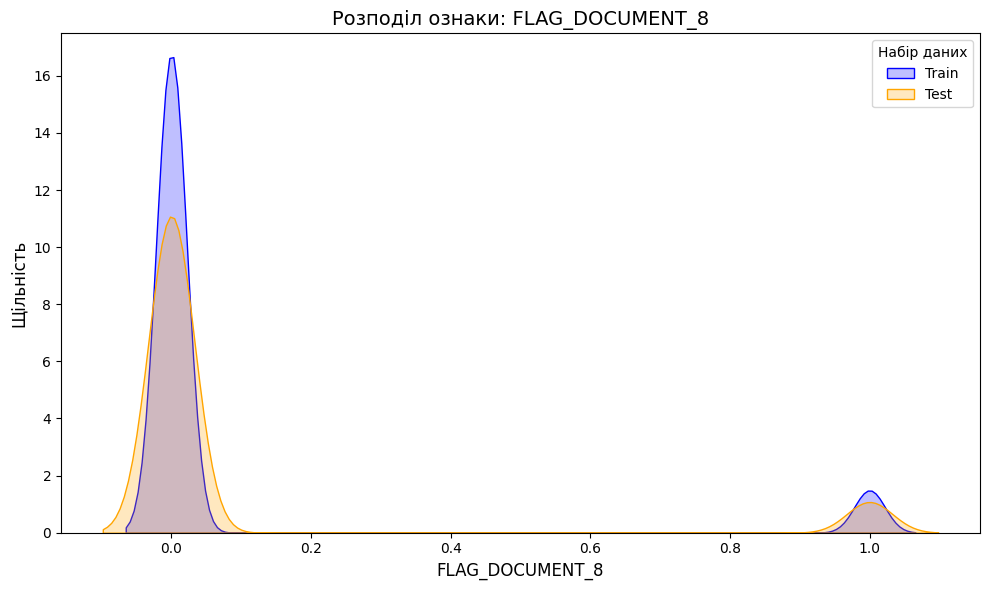

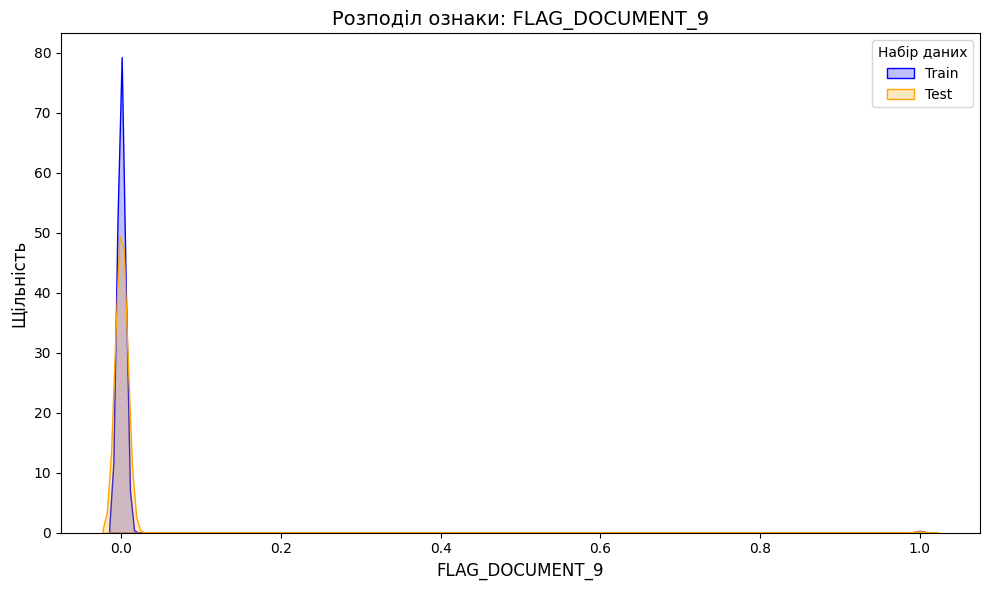

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


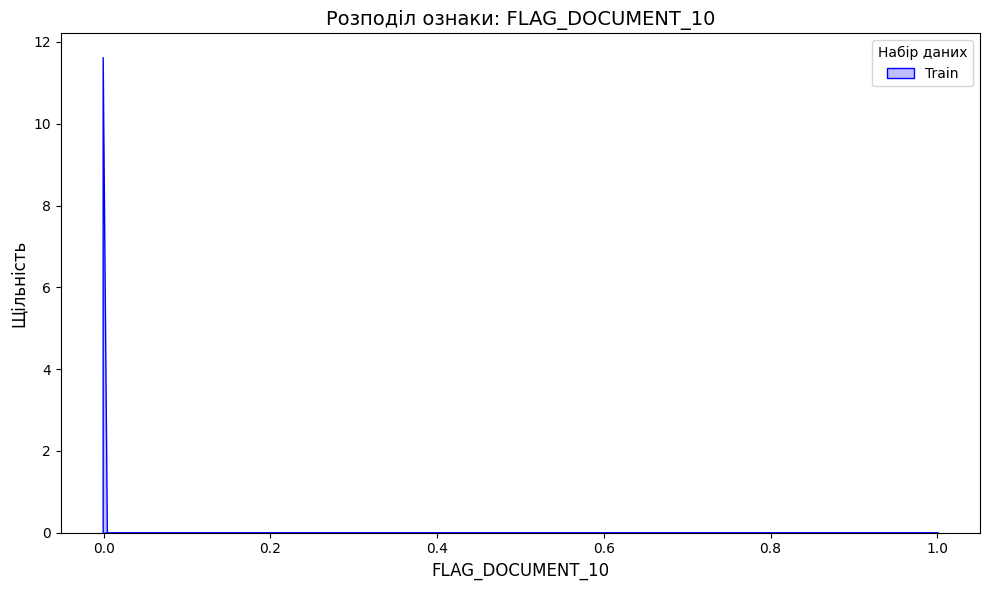

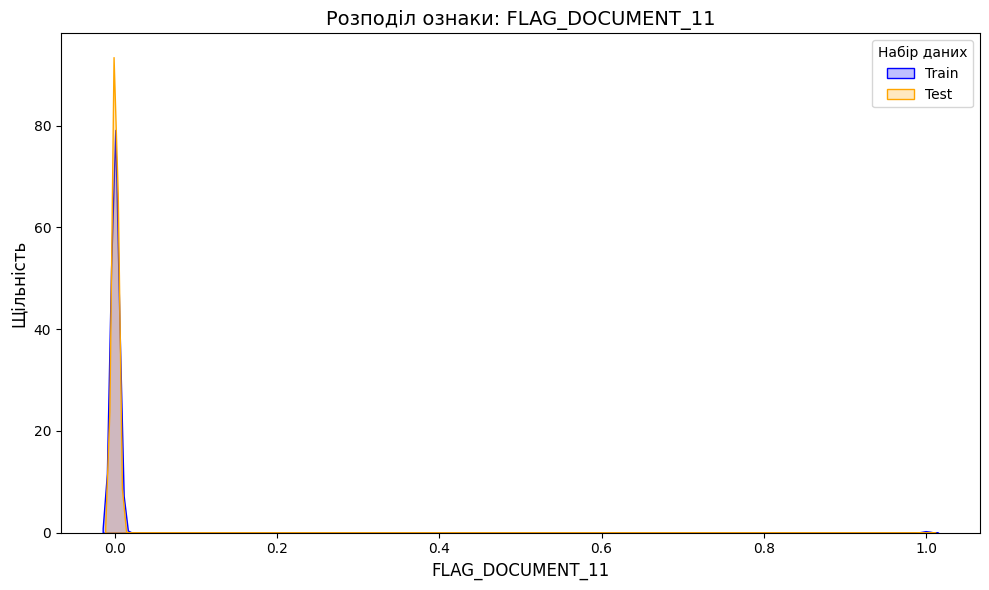

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


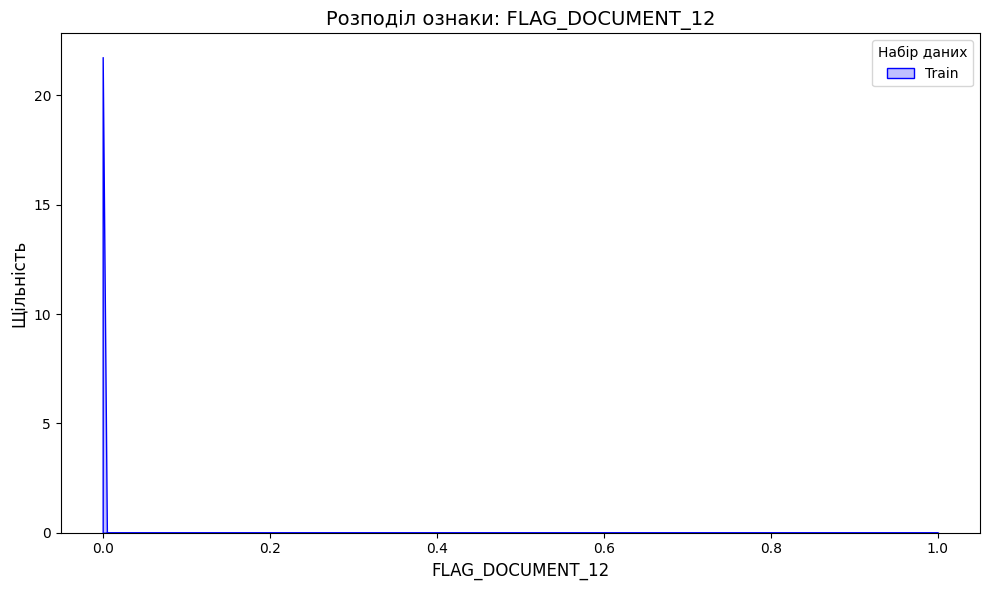

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


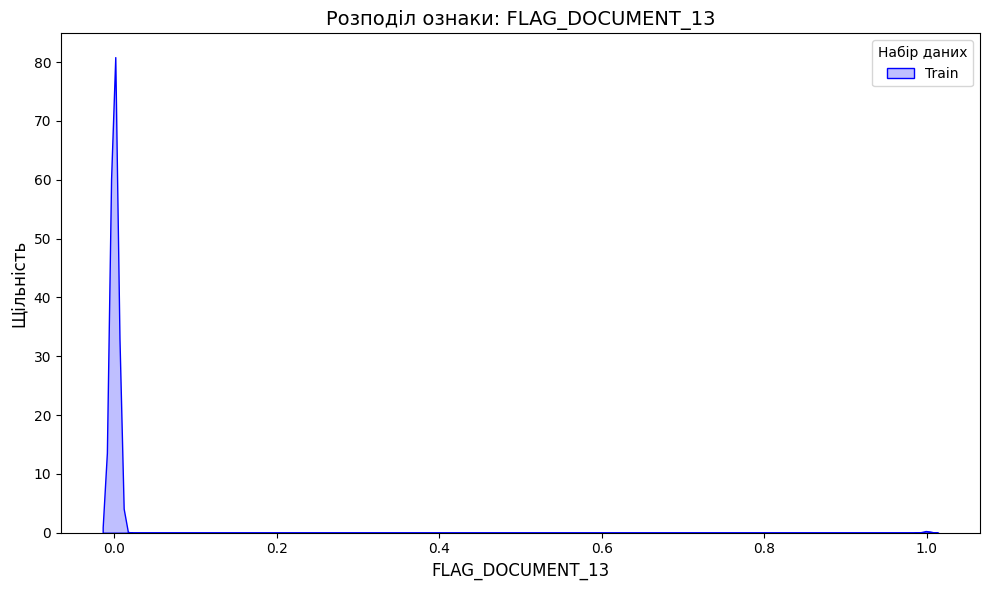

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


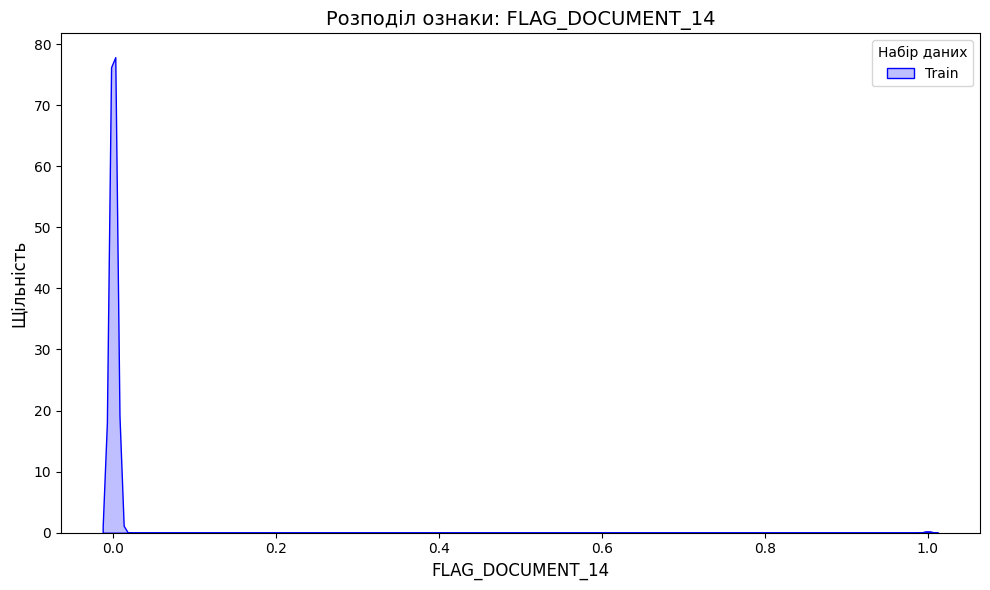

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


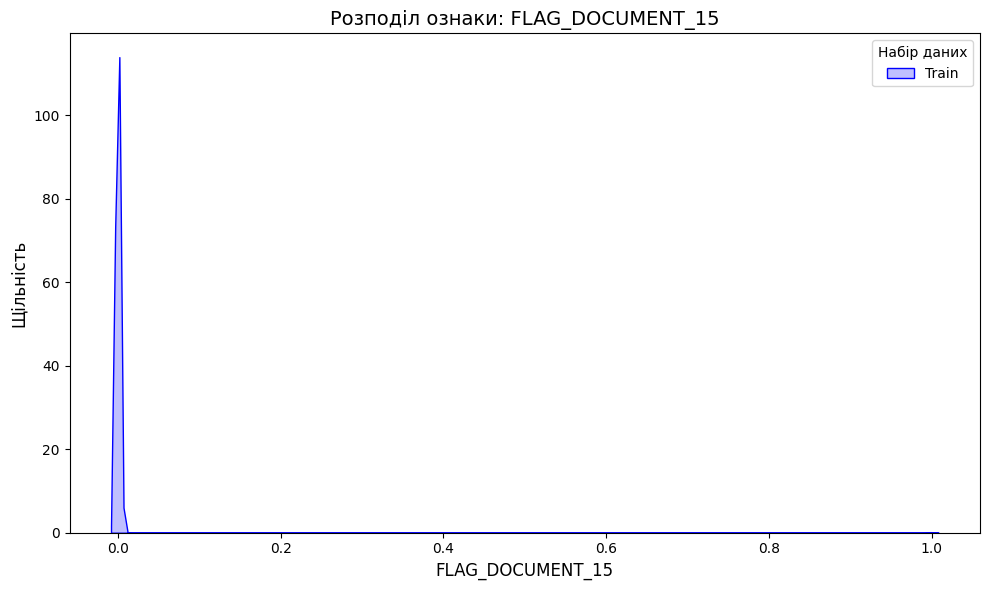

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


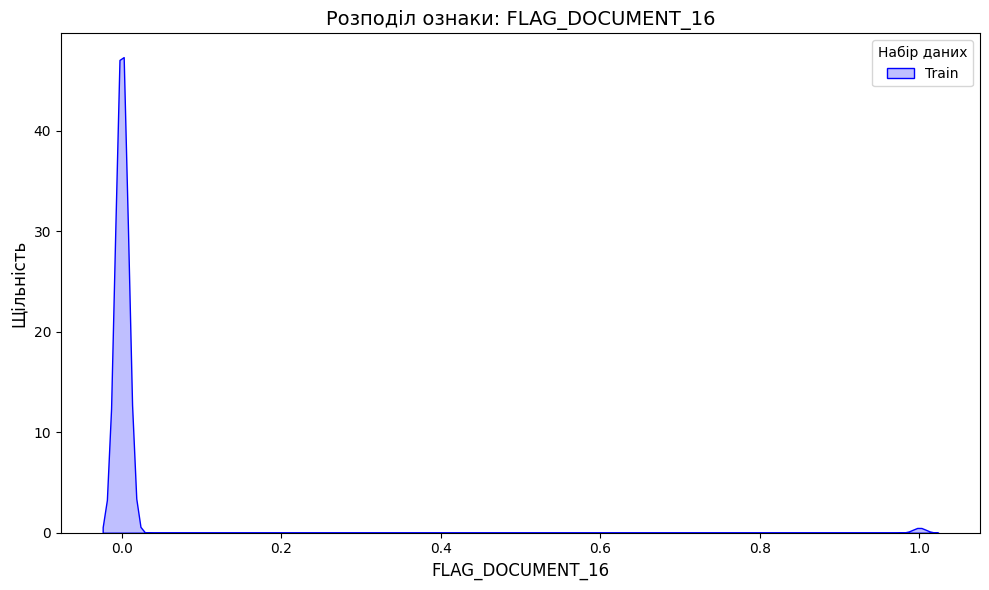

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


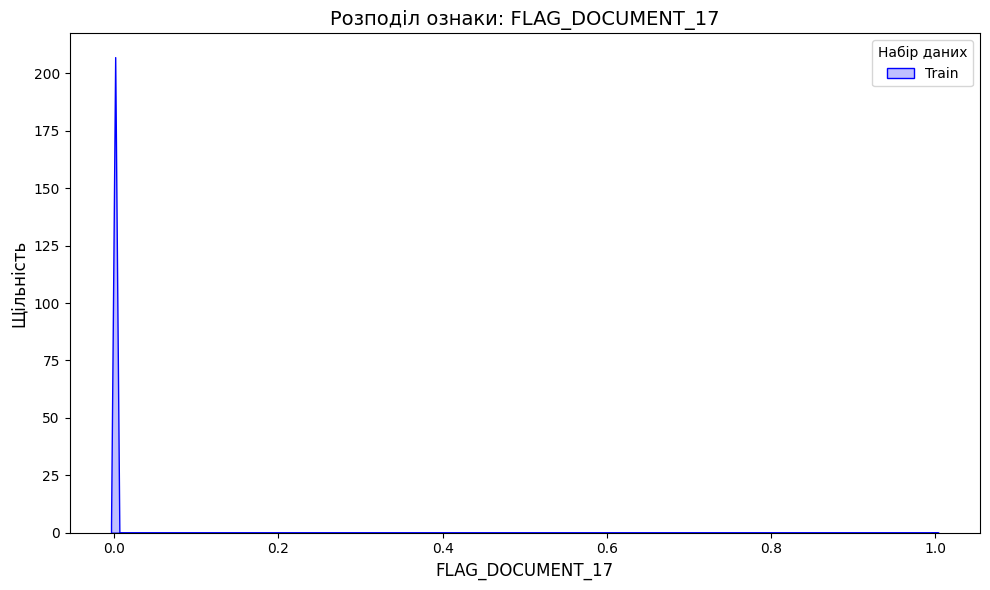

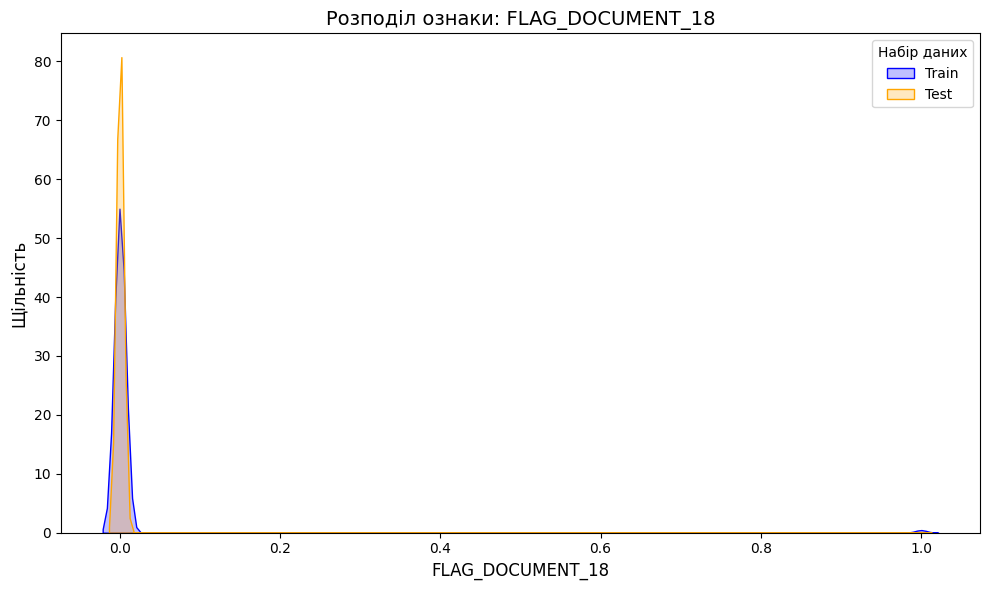

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


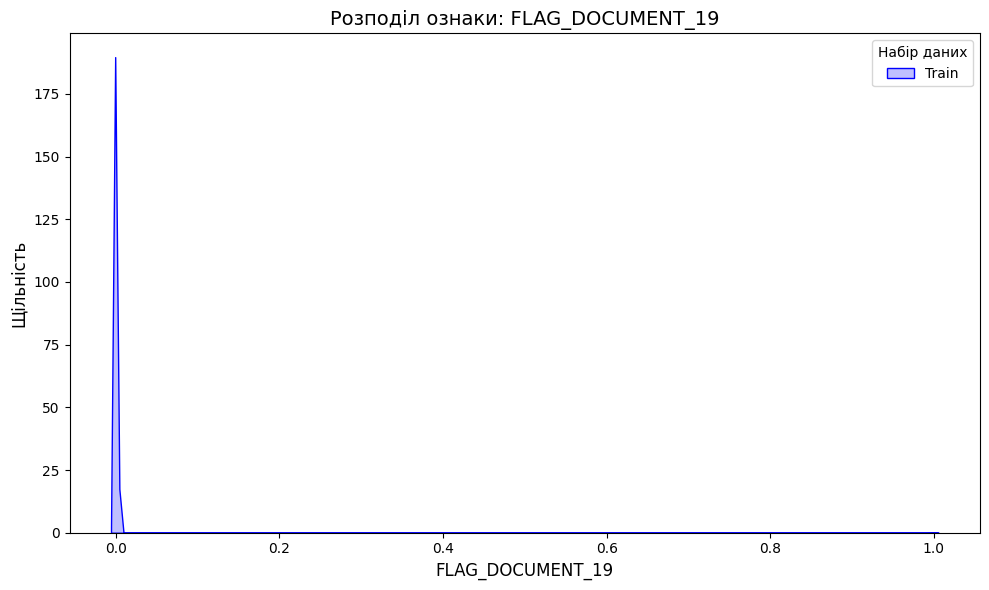

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


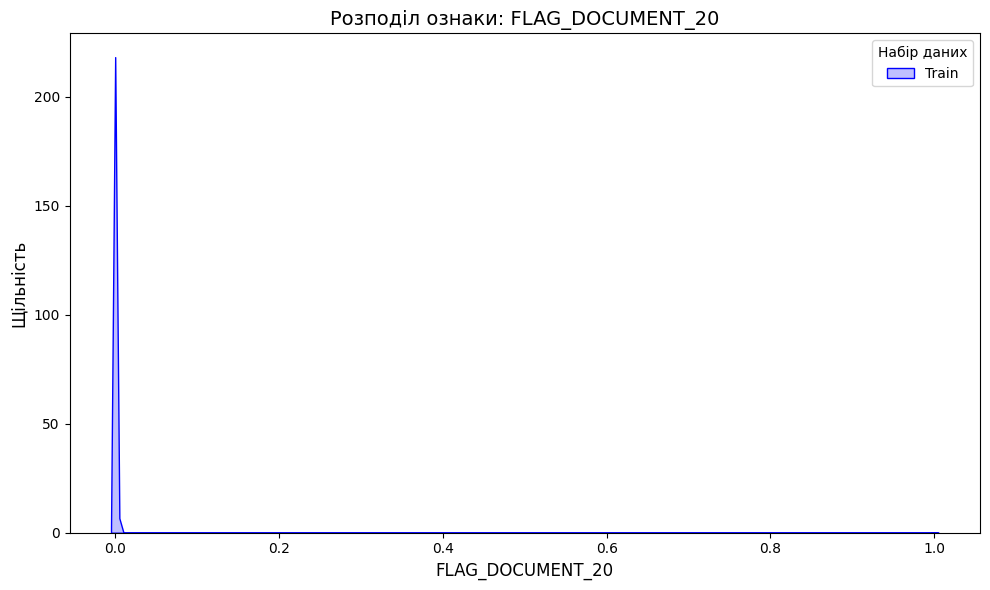

C:\Users\alext\AppData\Local\Temp\ipykernel_24632\2970946922.py:6: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")


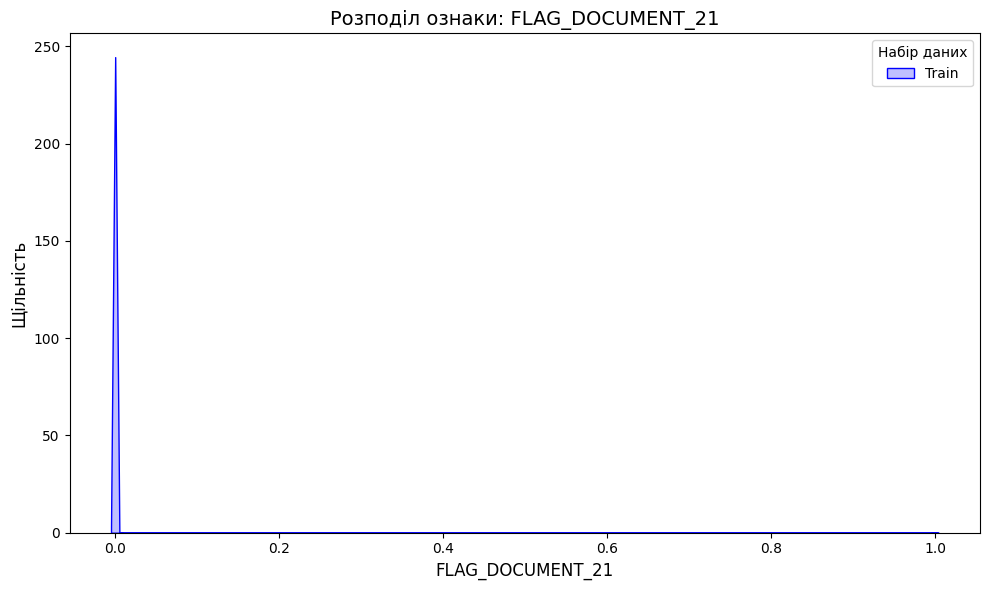

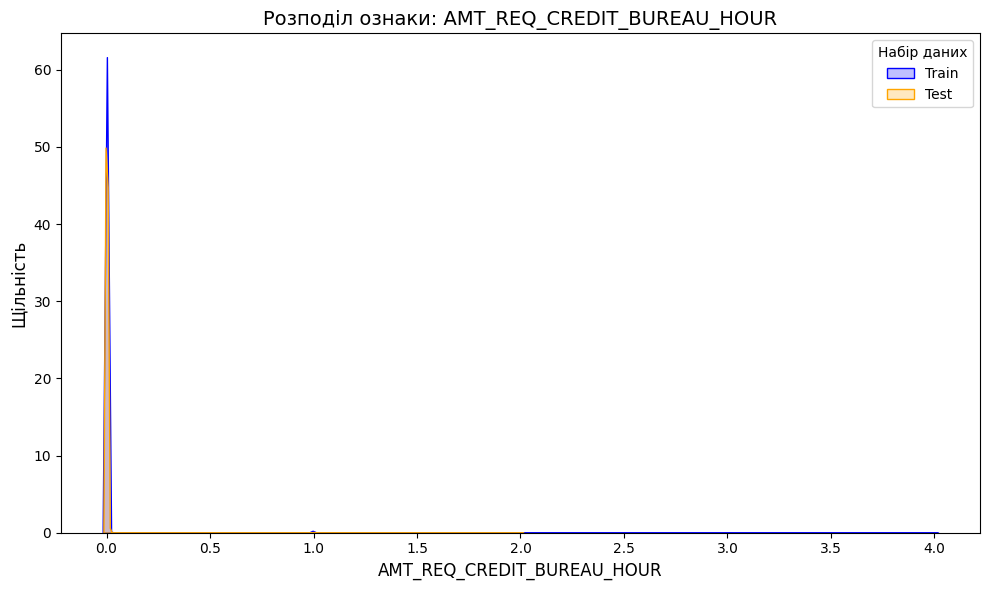

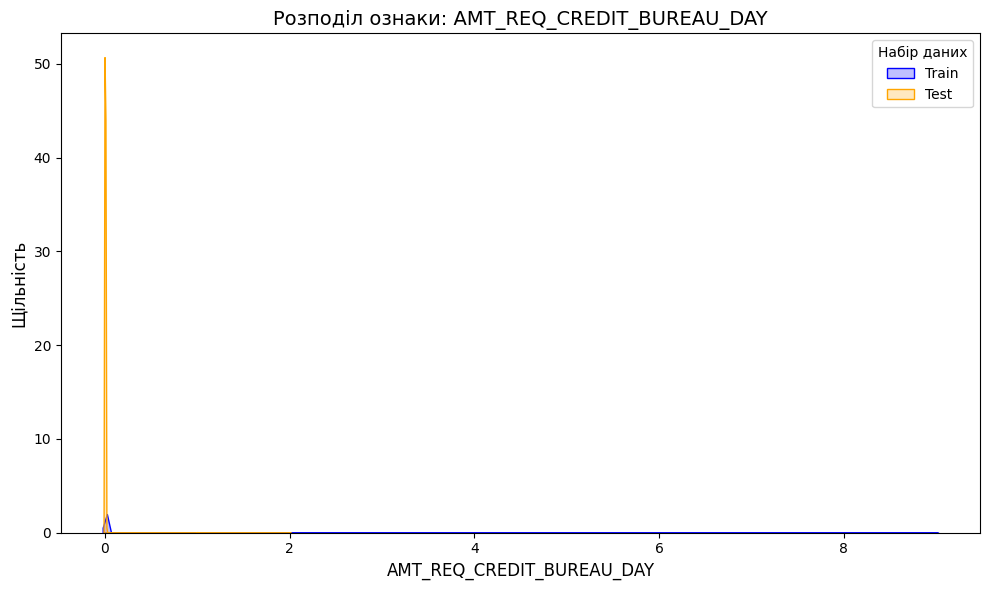

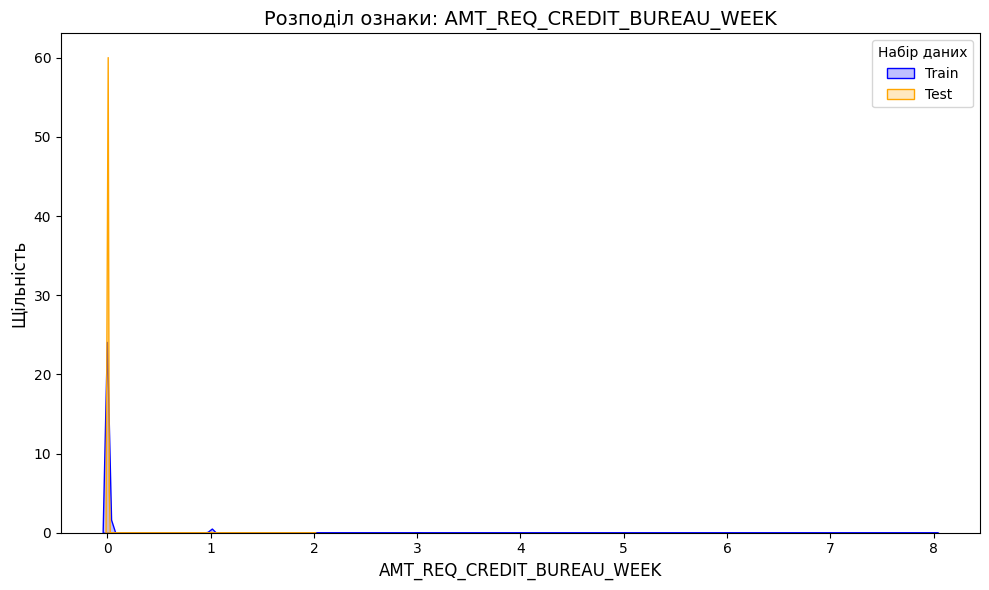

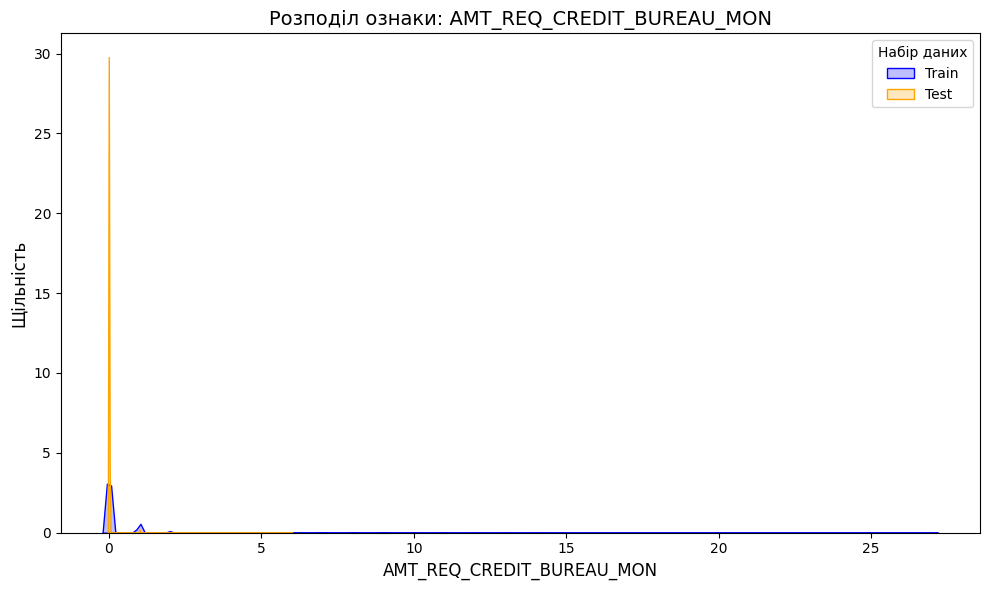

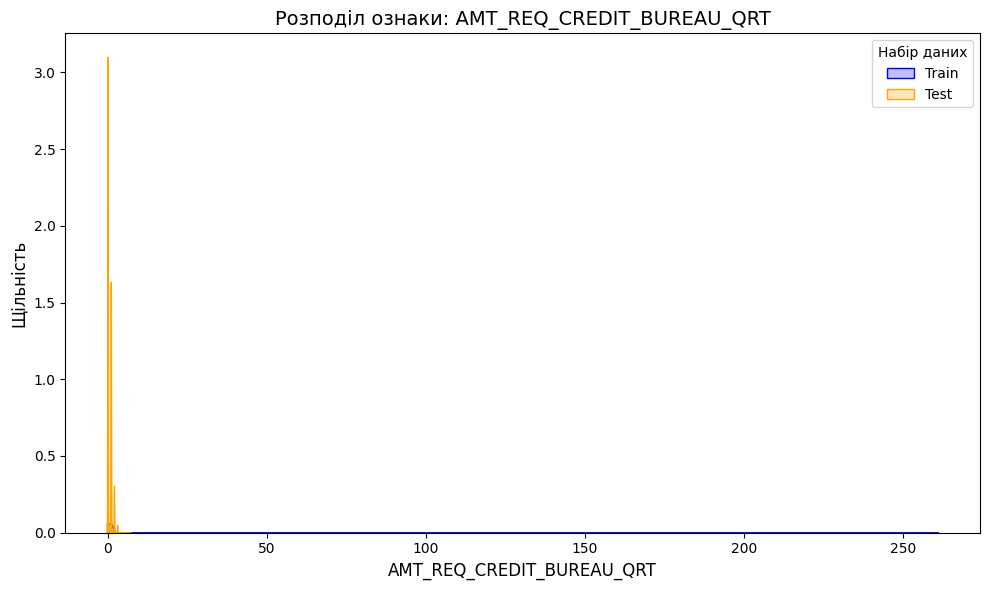

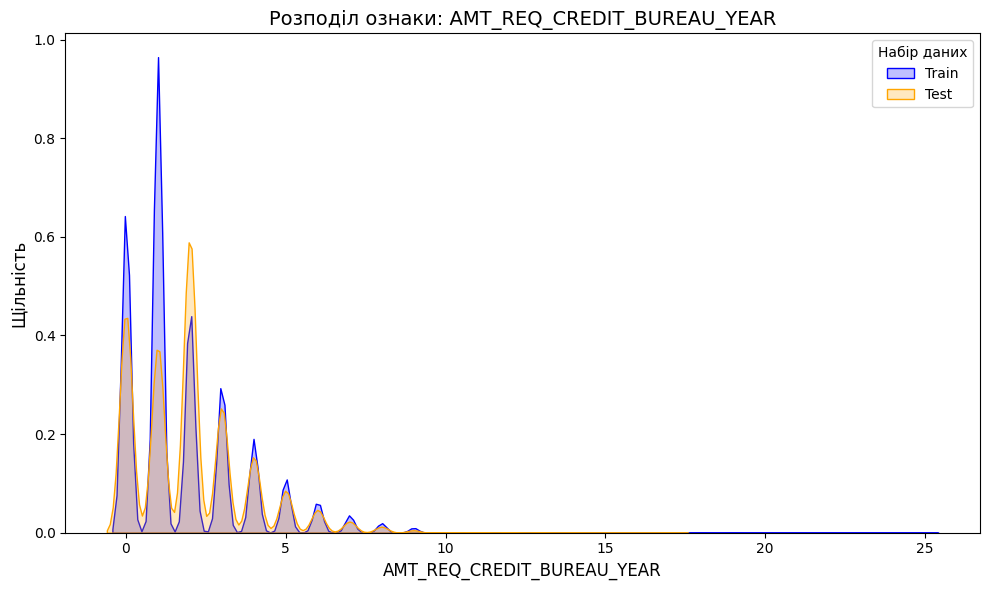

In [90]:
for feature in numerical_columns:
    if feature != "TARGET":
        plt.figure(figsize=(10, 6))

        sns.kdeplot(data=train_data[feature], label="Train", fill=True, color="blue")
        sns.kdeplot(data=test_data[feature], label="Test", fill=True, color="orange")

        plt.title(f"Розподіл ознаки: {feature}", fontsize=14)
        plt.xlabel(feature, fontsize=12)
        plt.ylabel("Щільність", fontsize=12)
        plt.legend(title="Набір даних")

        plt.tight_layout()
        plt.show()

Побудуємо класифікатор на основі проаналізованих даних.
Підключимо потрібні бібліотеки:


In [91]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score

Попередня обробка даних (preprocessing).
Для категоріальних даних було використано OneHotEncoder, для числових StandardScaler, який приводить числові дані до стандартного нормального розподілу


In [92]:
train_data["TARGET"]

0         1
1         0
2         0
3         0
4         0
5         0
6         0
7         0
8         0
9         0
10        0
11        0
12        0
13        0
14        0
15        0
16        0
17        0
18        0
19        0
20        0
21        0
22        0
23        0
24        0
25        0
26        1
27        0
28        0
29        0
30        0
31        0
32        0
33        0
34        0
35        0
36        0
37        0
38        0
39        0
40        1
41        0
42        1
43        0
44        0
45        0
46        0
47        0
48        0
49        0
50        0
51        0
52        0
53        0
54        0
55        0
56        0
57        0
58        0
59        0
60        0
61        0
62        0
63        0
64        0
65        0
66        0
67        0
68        0
69        0
70        0
71        0
72        0
73        0
74        0
75        0
76        0
77        0
78        0
79        0
80        0
81        1
82        0
83  

In [93]:
numerical_columns

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL', 'FLAG_EMP_PHONE',
       'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6',
       'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMEN

In [94]:
transformer = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(), categorical_columns),
        ("num", StandardScaler(), numerical_columns.drop("TARGET")),
    ]
)
transformer.fit(train_data)

ColumnTransformer(transformers=[('cat', OneHotEncoder(),
                                 Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'WEEKDAY_APPR_PROCESS_START',
       'ORGANIZATION_TYPE'],
      dtype='object')),
                                ('num', StandardScaler(),
                                 Index(['SK_ID_CURR', 'CNT_CHIL...
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18',
       'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21',
       'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object'))])

In [95]:
train_data["TARGET"]

0         1
1         0
2         0
3         0
4         0
5         0
6         0
7         0
8         0
9         0
10        0
11        0
12        0
13        0
14        0
15        0
16        0
17        0
18        0
19        0
20        0
21        0
22        0
23        0
24        0
25        0
26        1
27        0
28        0
29        0
30        0
31        0
32        0
33        0
34        0
35        0
36        0
37        0
38        0
39        0
40        1
41        0
42        1
43        0
44        0
45        0
46        0
47        0
48        0
49        0
50        0
51        0
52        0
53        0
54        0
55        0
56        0
57        0
58        0
59        0
60        0
61        0
62        0
63        0
64        0
65        0
66        0
67        0
68        0
69        0
70        0
71        0
72        0
73        0
74        0
75        0
76        0
77        0
78        0
79        0
80        0
81        1
82        0
83  

Використаємо наш створений трансформер на наших даних:


In [96]:
X_train = transformer.transform(train_data.drop("TARGET", axis=1))
y_train = train_data["TARGET"]
X_test = transformer.transform(test_data)

Розділимо тренувальні дані на тренувальні дані + дані для валідації:


In [97]:
X_train_s, X_valid, y_train_s, y_valid = train_test_split(
    X_train, y_train, test_size=0.25, random_state=42
)

Навчимо модель логістичної регресії:


In [124]:
clf = LogisticRegression(class_weight="balanced", max_iter=300)
clf.fit(X_train_s, y_train_s)

LogisticRegression(class_weight='balanced', max_iter=300)

Оцінимо модель на валідаційному наборі данних:


In [125]:
y_pred = clf.predict(X_valid)

precision = precision_score(y_valid, y_pred)
recall = recall_score(y_valid, y_pred)
f1 = f1_score(y_valid, y_pred)


roc_auc = roc_auc_score(y_valid, clf.predict_proba(X_valid)[:, 1])


print(f"precision: {precision:.2f}")
print(f"recall: {recall:.2f}")
print(f"f1: {f1:.2f}")
print(f"roc auc: {roc_auc:.2f}")

precision: 0.16
recall: 0.67
f1: 0.25
roc auc: 0.74


Зробимо прогнози на тестових даних:


In [126]:
test_predict = clf.predict(X_test)

Збережемо результати у файл submission:


In [127]:
last = pd.read_csv("sample_submission.csv")
last["TARGET"] = test_predict
last.to_csv("last_submission.csv", index=False)

Після залиття файлу на платформу отримуємо результат:


![lab2_result.png](lab2_result1.png)
